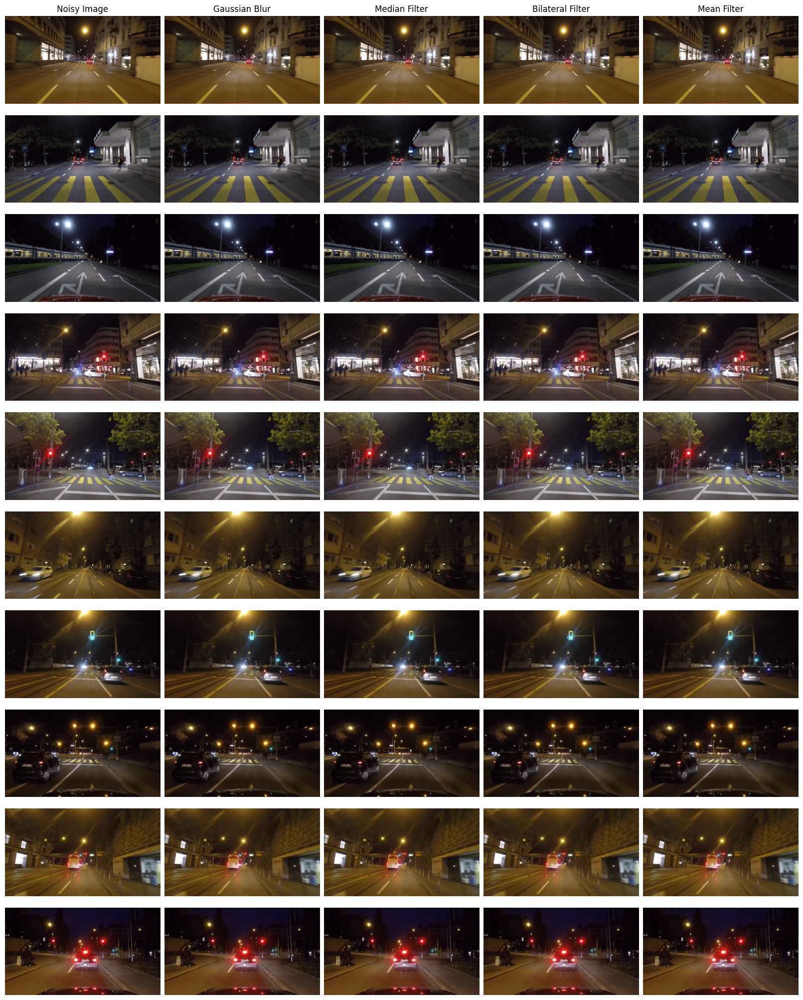

                        Image  Gaussian Blur (Linear) PSNR  Gaussian Blur (Linear) SSIM  Median Filter (Non-Linear) PSNR  Median Filter (Non-Linear) SSIM  Bilateral Filter (Non-Linear) PSNR  Bilateral Filter (Non-Linear) SSIM  Mean Filter (Linear) PSNR  Mean Filter (Linear) SSIM            Best Filter
01_frame_0906_leftImg8bit.png                        39.11                       0.9800                            38.27                           0.9722                               40.72                              0.9627                      35.34                     0.9606 Gaussian Blur (Linear)
01_frame_0956_leftImg8bit.png                        39.35                       0.9804                            38.17                           0.9727                               40.51                              0.9623                      35.58                     0.9604 Gaussian Blur (Linear)
01_frame_1536_leftImg8bit.png                        40.08                       0.9848    

In [1]:

import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim
import os
import pandas as pd

# Load all noisy images from a folder
image_folder = "noisy_images"  # Folder containing noisy images
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]
noisy_images = [cv2.imread(os.path.join(image_folder, f)) for f in image_files]

if not noisy_images:
    raise FileNotFoundError("Error: No noisy images found in the specified folder!")

# Convert to grayscale (if needed for SSIM comparison)
noisy_gray_images = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in noisy_images]

# Function to apply filters
def apply_filters(image):
    return {
        "Gaussian Blur (Linear)": cv2.GaussianBlur(image, (5, 5), 0),
        "Median Filter (Non-Linear)": cv2.medianBlur(image, 5),
        "Bilateral Filter (Non-Linear)": cv2.bilateralFilter(image, 9, 75, 75),
        "Mean Filter (Linear)": cv2.blur(image, (5, 5))
    }

# Apply filters to all images
filtered_images = [apply_filters(img) for img in noisy_images]

# Visualize first 10 images with filters in a single compact plot
num_images_to_show = min(10, len(noisy_images))
fig, axes = plt.subplots(num_images_to_show, 5, figsize=(16, 2.0 * num_images_to_show), constrained_layout=True)
filter_names = ["Noisy Image", "Gaussian Blur", "Median Filter", "Bilateral Filter", "Mean Filter"]

for ax, name in zip(axes[0], filter_names):
    ax.set_title(name)

for i in range(num_images_to_show):
    axes[i, 0].imshow(cv2.cvtColor(noisy_images[i], cv2.COLOR_BGR2RGB))
    axes[i, 0].axis("off")
    
    for j, filtered in enumerate(filtered_images[i].values(), start=1):
        axes[i, j].imshow(cv2.cvtColor(filtered, cv2.COLOR_BGR2RGB))
        axes[i, j].axis("off")
    
plt.show()

# Evaluate filters using PSNR & SSIM
results = []
for img_idx, (noisy_gray, filtered_set) in enumerate(zip(noisy_gray_images, filtered_images)):
    img_results = {}
    for name, filtered in filtered_set.items():
        filtered_gray = cv2.cvtColor(filtered, cv2.COLOR_BGR2GRAY)
        psnr_value = psnr(noisy_gray, filtered_gray)
        ssim_value = ssim(noisy_gray, filtered_gray)
        img_results[name] = (psnr_value, ssim_value)
    results.append(img_results)

# Create a DataFrame for tabular output
summary_data = []
for img_idx, img_results in enumerate(results):
    best_filter = max(img_results, key=lambda k: img_results[k][1])  # Choose based on highest SSIM
    row = {"Image": image_files[img_idx]}
    for name, (psnr_value, ssim_value) in img_results.items():
        row[f"{name} PSNR"] = round(psnr_value, 2)
        row[f"{name} SSIM"] = round(ssim_value, 4)
    row["Best Filter"] = best_filter
    summary_data.append(row)

df = pd.DataFrame(summary_data)

# Print the DataFrame in a structured format like an Excel table
print(df.to_string(index=False))

# Determine the best overall filter across all images
best_filters = [row["Best Filter"] for row in summary_data]
overall_best_filter = max(set(best_filters), key=best_filters.count)
# Extract the best-filtered images based on highest SSIM
best_filtered_images = [
    filtered_images[idx][row["Best Filter"]] for idx, row in enumerate(summary_data)
]

# Ensure best_filtered_images is valid
if not isinstance(best_filtered_images, list) or not all(isinstance(img, np.ndarray) for img in best_filtered_images):
    raise ValueError("Error: best_filtered_images is not a valid list of NumPy arrays!")

print(f"Overall Best Filter Across All Images: {overall_best_filter}")


Applying binary segmentation: 100%|██████████| 10/10 [00:30<00:00,  3.01s/image]


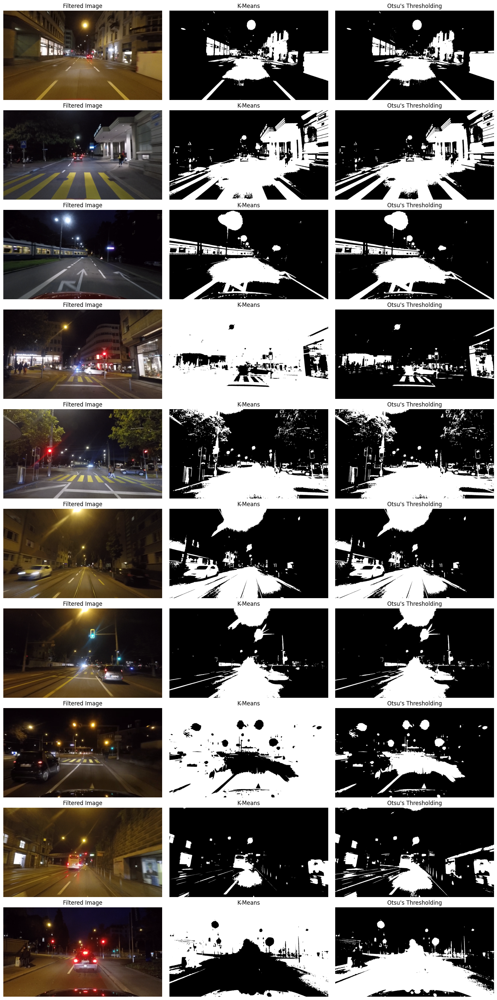

Evaluating binary segmentation: 100%|██████████| 10/10 [00:01<00:00,  5.39image/s]

                        Image  K-Means  Otsu's Thresholding   Best Method (ARE)
01_frame_0906_leftImg8bit.png   0.0258                  0.0 Otsu's Thresholding
01_frame_0956_leftImg8bit.png   0.0031                  0.0 Otsu's Thresholding
01_frame_1536_leftImg8bit.png   0.0135                  0.0 Otsu's Thresholding
 0_frame_0075_leftImg8bit.png   0.0304                  0.0 Otsu's Thresholding
 0_frame_0205_leftImg8bit.png   0.0404                  0.0 Otsu's Thresholding
 0_frame_0932_leftImg8bit.png   0.0076                  0.0 Otsu's Thresholding
 0_frame_1434_leftImg8bit.png   0.0137                  0.0 Otsu's Thresholding
 0_frame_1687_leftImg8bit.png   0.0297                  0.0 Otsu's Thresholding
 0_frame_1816_leftImg8bit.png   0.3246                  0.0 Otsu's Thresholding
 0_frame_2728_leftImg8bit.png   0.0372                  0.0 Otsu's Thresholding
Best Binary Segmentation Method: Otsu's Thresholding


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from skimage.metrics import adapted_rand_error as are, variation_of_information as vi
from sklearn.cluster import KMeans
from skimage.filters import threshold_otsu
from skimage.segmentation import felzenszwalb, slic
from scipy import ndimage
import os
from tqdm import tqdm  # progress bar
 
# Ensure best_filtered_images is valid
if not isinstance(best_filtered_images, list) or not all(isinstance(img, np.ndarray) for img in best_filtered_images):
    raise ValueError("Error: best_filtered_images is not a valid list of NumPy arrays!")

# Function to apply binary segmentation algorithms
def apply_binary_segmentation(image):
    if image is None or not isinstance(image, np.ndarray):
        return None  # Skip invalid images
    
    # K-Means Segmentation (on RGB image)
    reshaped = image.reshape((-1, 3))
    kmeans = KMeans(n_clusters=2, n_init=10, random_state=42)
    kmeans_labels = kmeans.fit_predict(reshaped)
    kmeans_segmented = kmeans_labels.reshape(image.shape[:2])
    
    # Otsu's Thresholding (on grayscale image)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    otsu_thresh = threshold_otsu(gray)
    otsu_segmented = (gray > otsu_thresh).astype(np.uint8)
    
    return {
        "K-Means": kmeans_segmented,
        "Otsu's Thresholding": otsu_segmented,
    }

# Apply binary segmentation
binary_segmented_images = [
    apply_binary_segmentation(img)
    for img in tqdm(best_filtered_images, desc="Applying binary segmentation", unit="image")
    if isinstance(img, np.ndarray)
]

# Visualize Binary Segmentation Results
binary_methods = ["K-Means", "Otsu's Thresholding"]
num_images_to_show = min(10, len(binary_segmented_images))
fig, axes = plt.subplots(num_images_to_show, 1 + len(binary_methods), figsize=(15, 3 * num_images_to_show), constrained_layout=True)

for i in range(num_images_to_show):
    axes[i, 0].imshow(cv2.cvtColor(best_filtered_images[i], cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Filtered Image")
    axes[i, 0].axis("off")
    
    for j, method in enumerate(binary_methods, start=1):
        segmented = binary_segmented_images[i][method]
        axes[i, j].imshow(segmented, cmap="gray")
        axes[i, j].set_title(method)
        axes[i, j].axis("off")
    
plt.show()

# Evaluate Binary Segmentation
binary_segmentation_results = []
for img_idx, seg_result in enumerate(tqdm(binary_segmented_images, desc="Evaluating binary segmentation", unit="image")):
    filtered_gray = cv2.cvtColor(best_filtered_images[img_idx], cv2.COLOR_BGR2GRAY)
    baseline_thresh = threshold_otsu(filtered_gray)
    baseline_seg = (filtered_gray > baseline_thresh).astype(np.uint8)
    
    img_scores = {}
    for method, segmented_img in seg_result.items():
        are_score, _, _ = are(baseline_seg, segmented_img)
        img_scores[method] = round(are_score, 4)
    
    best_method_are = min(img_scores, key=img_scores.get)  
    row = {"Image": image_files[img_idx], **img_scores, "Best Method (ARE)": best_method_are}
    binary_segmentation_results.append(row)

df_binary_segmentation = pd.DataFrame(binary_segmentation_results)
print(df_binary_segmentation.to_string(index=False))

best_binary_method = df_binary_segmentation["Best Method (ARE)"].value_counts().idxmax()
print(f"Best Binary Segmentation Method: {best_binary_method}")


Applying multi-region segmentation: 100%|██████████| 10/10 [01:44<00:00, 10.44s/image]


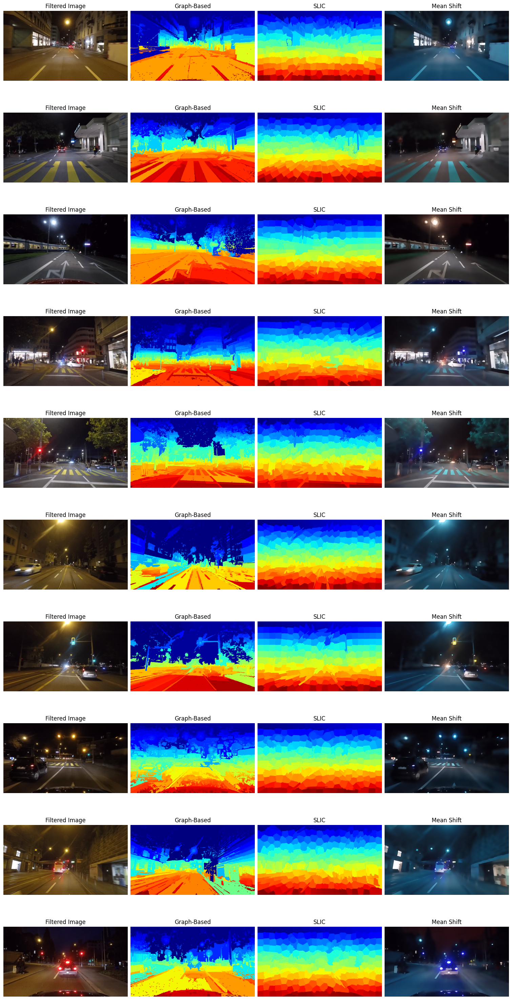

Evaluating multi-region segmentation: 100%|██████████| 10/10 [00:02<00:00,  3.88image/s]

                        Image  Graph-Based   SLIC Best Method (VI)
01_frame_0906_leftImg8bit.png       5.3553 7.4008      Graph-Based
01_frame_0956_leftImg8bit.png       6.5453 7.2852      Graph-Based
01_frame_1536_leftImg8bit.png       6.2176 7.4207      Graph-Based
 0_frame_0075_leftImg8bit.png       6.9208 7.5330      Graph-Based
 0_frame_0205_leftImg8bit.png       7.2117 7.3028      Graph-Based
 0_frame_0932_leftImg8bit.png       4.6164 7.3579      Graph-Based
 0_frame_1434_leftImg8bit.png       5.1854 7.3564      Graph-Based
 0_frame_1687_leftImg8bit.png       8.1869 7.5175             SLIC
 0_frame_1816_leftImg8bit.png       5.3812 7.5770      Graph-Based
 0_frame_2728_leftImg8bit.png       5.5512 7.1702      Graph-Based
Best Multi-Region Segmentation Method: Graph-Based


In [3]:
# Function to apply multi-region segmentation algorithms
def apply_multi_region_segmentation(image):
    if image is None or not isinstance(image, np.ndarray):
        return None  # Skip invalid images
    
    # Graph-Based Segmentation using Felzenszwalb's algorithm (on RGB image)
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    graph_segmented = felzenszwalb(rgb_image, scale=100, sigma=0.5, min_size=50)
    
    # SLIC Superpixel Segmentation (color-based)
    slic_segmented = slic(rgb_image, n_segments=250, compactness=10, sigma=1, start_label=1)
    
    # Mean Shift Segmentation using OpenCV's pyrMeanShiftFiltering (color-based)
    ms_image = cv2.pyrMeanShiftFiltering(image, sp=21, sr=51)
    
    return {
        "Graph-Based": graph_segmented,
        "SLIC": slic_segmented,
        "Mean Shift": ms_image,
    }

# Apply multi-region segmentation
multi_region_segmented_images = [
    apply_multi_region_segmentation(img)
    for img in tqdm(best_filtered_images, desc="Applying multi-region segmentation", unit="image")
    if isinstance(img, np.ndarray)
]

# Visualize Multi-Region Segmentation Results
multi_region_methods = ["Graph-Based", "SLIC", "Mean Shift"]
fig, axes = plt.subplots(num_images_to_show, 1 + len(multi_region_methods), figsize=(15, 3 * num_images_to_show), constrained_layout=True)

for i in range(num_images_to_show):
    axes[i, 0].imshow(cv2.cvtColor(best_filtered_images[i], cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Filtered Image")
    axes[i, 0].axis("off")
    
    for j, method in enumerate(multi_region_methods, start=1):
        segmented = multi_region_segmented_images[i][method]
        cmap = None if method == "Mean Shift" else "jet"
        axes[i, j].imshow(segmented, cmap=cmap)
        axes[i, j].set_title(method)
        axes[i, j].axis("off")
    
plt.show()

# Evaluate Multi-Region Segmentation
multi_region_results = []
for img_idx, seg_result in enumerate(tqdm(multi_region_segmented_images, desc="Evaluating multi-region segmentation", unit="image")):
    filtered_gray = cv2.cvtColor(best_filtered_images[img_idx], cv2.COLOR_BGR2GRAY)
    baseline_thresh = threshold_otsu(filtered_gray)
    baseline_seg = (filtered_gray > baseline_thresh).astype(np.uint8)
    
    vi_scores = {}
    for method, segmented_img in seg_result.items():
        if method == "Mean Shift":
            continue  # Skip Mean Shift for VI evaluation
        vi_score = sum(vi(baseline_seg, segmented_img))
        vi_scores[method] = round(vi_score, 4)
    
    best_method_vi = min(vi_scores, key=vi_scores.get)
    row = {"Image": image_files[img_idx], **vi_scores, "Best Method (VI)": best_method_vi}
    multi_region_results.append(row)

df_multi_region = pd.DataFrame(multi_region_results)
print(df_multi_region.to_string(index=False))

best_multi_region_method = df_multi_region["Best Method (VI)"].value_counts().idxmax()
print(f"Best Multi-Region Segmentation Method: {best_multi_region_method}")


Combining segmentations: 100%|██████████| 10/10 [02:00<00:00, 12.08s/image]


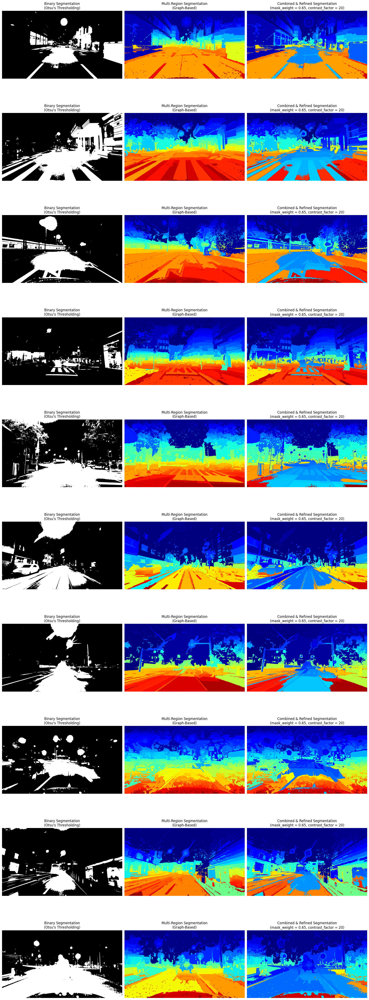

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.measure import regionprops
from skimage import morphology
from tqdm import tqdm  # progress bar

def refine_segmentation(segmentation, min_area=64):
    """
    Refine segmentation by merging small regions with their dominant neighboring region.
    """
    refined = segmentation.copy()
    regions = regionprops(refined)
    
    for region in regions:
        if region.label == 0 or region.area >= min_area:
            continue
        
        coords = region.coords
        neighbor_labels = []
        for (r, c) in coords:
            for dr in [-1, 0, 1]:
                for dc in [-1, 0, 1]:
                    if dr == 0 and dc == 0:
                        continue
                    nr, nc = r + dr, c + dc
                    if 0 <= nr < refined.shape[0] and 0 <= nc < refined.shape[1]:
                        neighbor_label = refined[nr, nc]
                        if neighbor_label != region.label:
                            neighbor_labels.append(neighbor_label)
        
        if neighbor_labels:
            new_label = max(set(neighbor_labels), key=neighbor_labels.count)
            refined[coords[:, 0], coords[:, 1]] = new_label

    refined = morphology.remove_small_objects(refined, min_size=min_area)
    return refined

# --- Inputs ---
# best_filtered_images: list of filtered images (NumPy arrays)
# binary_segmented_images: list of dicts with binary segmentation results for each image.
# multi_region_segmented_images: list of dicts with multi-region segmentation results for each image.
# best_binary_method: string key for binary segmentation (e.g., "Otsu's Thresholding")
# best_multi_region_method: string key for multi-region segmentation (e.g., "SLIC")

# Hyperparameter: controls the proportional suppression of the multi-region segmentation.
mask_weight = 0.65  # Adjust between 0 and 1

# Hyperparameter: increases the contrast of the multi-region segmentation.
# Multiplying the label values by this factor will accentuate differences.
contrast_factor = 20  # Adjust this value as needed

# Hyperparameter: Gaussian kernel size for smoothing (to reduce salt & pepper noise)
gaussian_kernel = (3, 3)  # Adjust kernel size as needed

combined_segmentations = []

for i in tqdm(range(len(best_filtered_images)), desc="Combining segmentations", unit="image"):
    # Get the binary segmentation and create a binary mask (values 0 or 1)
    binary_seg = binary_segmented_images[i][best_binary_method]
    binary_mask = (binary_seg > 0).astype(np.uint8)
    
    # Compute a suppression factor based on the binary mask.
    # In regions where binary_mask==1, factor becomes (1 - mask_weight); elsewhere, it remains 1.
    factor = 1 - mask_weight * binary_mask
    
    # Get the multi-region segmentation and ensure it is in integer format.
    multi_seg = multi_region_segmented_images[i][best_multi_region_method]
    if multi_seg.dtype not in [np.int32, np.int64]:
        multi_seg = multi_seg.astype(np.int32)
    
    # Apply Gaussian smoothing to reduce salt & pepper noise.
    # Convert to float32 to ensure proper smoothing, then later use the result.
    multi_seg = cv2.GaussianBlur(multi_seg.astype(np.float32), gaussian_kernel, sigmaX=0)
    
    # Apply the contrast hyperparameter to increase segmentation contrast.
    multi_seg = multi_seg * contrast_factor
    
    # Multiply the multi-region segmentation by the computed suppression factor.
    combined_seg = multi_seg * factor
    # Convert the result to integer type.
    combined_seg = np.round(combined_seg).astype(np.int32)
    
    # Refine the combined segmentation.
    refined_combined_seg = refine_segmentation(combined_seg, min_area=64)
    
    combined_segmentations.append(refined_combined_seg)

# -----------------------------------------
# Visualization: Binary, Multi-region, and Combined & Refined segmentation.
# -----------------------------------------
num_images_to_show = min(len(best_filtered_images), len(combined_segmentations))
fig, axes = plt.subplots(num_images_to_show, 3, figsize=(18, 5 * num_images_to_show), constrained_layout=True)

for i in range(num_images_to_show):
    # Binary segmentation result.
    axes[i, 0].imshow(binary_segmented_images[i][best_binary_method], cmap="gray")
    axes[i, 0].set_title(f"Binary Segmentation\n({best_binary_method})")
    axes[i, 0].axis("off")
    
    # Multi-region segmentation result.
    axes[i, 1].imshow(multi_region_segmented_images[i][best_multi_region_method], cmap="jet")
    axes[i, 1].set_title(f"Multi-Region Segmentation\n({best_multi_region_method})")
    axes[i, 1].axis("off")
    
    # Combined & refined segmentation.
    axes[i, 2].imshow(combined_segmentations[i], cmap="jet")
    axes[i, 2].set_title(f"Combined & Refined Segmentation\n(mask_weight = {mask_weight}, contrast_factor = {contrast_factor})")
    axes[i, 2].axis("off")

plt.show()

Combining segmentations: 100%|██████████| 10/10 [00:03<00:00,  2.53image/s]


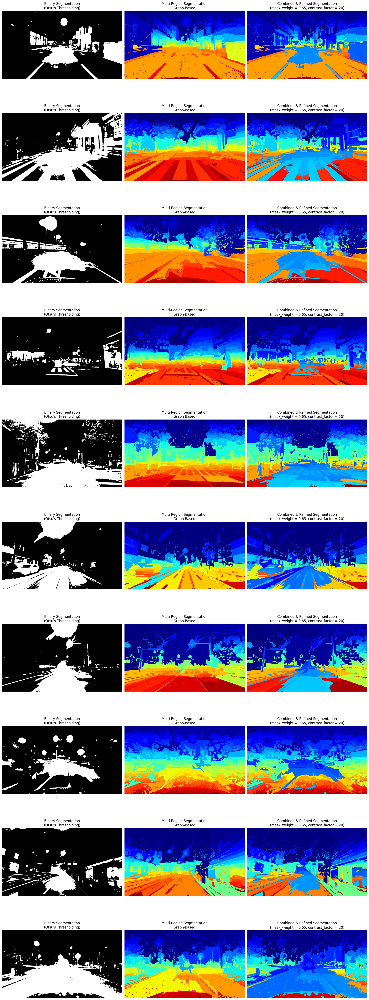

In [5]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.measure import regionprops
from skimage import morphology
from tqdm import tqdm  # progress bar

def refine_segmentation(segmentation, min_area=64):
    """
    Refine segmentation by merging small regions with their dominant neighboring region.
    """
    refined = segmentation.copy()
    regions = regionprops(refined)
    
    for region in regions:
        if region.label == 0 or region.area >= min_area:
            continue
        
        coords = region.coords
        neighbor_labels = []
        for (r, c) in coords:
            for dr in [-1, 0, 1]:
                for dc in [-1, 0, 1]:
                    if dr == 0 and dc == 0:
                        continue
                    nr, nc = r + dr, c + dc
                    if 0 <= nr < refined.shape[0] and 0 <= nc < refined.shape[1]:
                        neighbor_label = refined[nr, nc]
                        if neighbor_label != region.label:
                            neighbor_labels.append(neighbor_label)
        
        if neighbor_labels:
            new_label = max(set(neighbor_labels), key=neighbor_labels.count)
            refined[coords[:, 0], coords[:, 1]] = new_label

    refined = morphology.remove_small_objects(refined, min_size=min_area)
    return refined

# --- Inputs ---
# best_filtered_images: list of filtered images (NumPy arrays)
# binary_segmented_images: list of dicts with binary segmentation results for each image.
# multi_region_segmented_images: list of dicts with multi-region segmentation results for each image.
# best_binary_method: string key for binary segmentation (e.g., "Otsu's Thresholding")
# best_multi_region_method: string key for multi-region segmentation (e.g., "SLIC")

# Hyperparameter: controls the proportional suppression of the multi-region segmentation.
mask_weight = 0.65  # Adjust between 0 and 1

# Hyperparameter: increases the contrast of the multi-region segmentation.
# Multiplying the label values by this factor will accentuate differences.
contrast_factor = 20  # Adjust this value as needed

combined_segmentations = []

for i in tqdm(range(len(best_filtered_images)), desc="Combining segmentations", unit="image"):
    # Get the binary segmentation and create a binary mask (values 0 or 1)
    binary_seg = binary_segmented_images[i][best_binary_method]
    binary_mask = (binary_seg > 0).astype(np.uint8)
    
    # Compute a suppression factor based on the binary mask.
    # In regions where binary_mask==1, factor becomes (1 - mask_weight); elsewhere, it remains 1.
    factor = 1 - mask_weight * binary_mask
    
    # Get the multi-region segmentation and ensure it is in integer format.
    multi_seg = multi_region_segmented_images[i][best_multi_region_method]
    if multi_seg.dtype not in [np.int32, np.int64]:
        multi_seg = multi_seg.astype(np.int32)
    
    # Apply the contrast hyperparameter to increase the segmentation contrast.
    multi_seg = multi_seg * contrast_factor
    
    # Multiply the multi-region segmentation by the computed suppression factor.
    combined_seg = multi_seg * factor
    # Convert the result to integer type.
    combined_seg = np.round(combined_seg).astype(np.int32)
    
    # Refine the combined segmentation.
    refined_combined_seg = refine_segmentation(combined_seg, min_area=64)
    
    combined_segmentations.append(refined_combined_seg)

# -----------------------------------------
# Visualization: Binary, Multi-region, and Combined & Refined segmentation.
# -----------------------------------------
num_images_to_show = min(len(best_filtered_images), len(combined_segmentations))
fig, axes = plt.subplots(num_images_to_show, 3, figsize=(18, 5 * num_images_to_show), constrained_layout=True)

for i in range(num_images_to_show):
    # Binary segmentation result.
    axes[i, 0].imshow(binary_segmented_images[i][best_binary_method], cmap="gray")
    axes[i, 0].set_title(f"Binary Segmentation\n({best_binary_method})")
    axes[i, 0].axis("off")
    
    # Multi-region segmentation result.
    axes[i, 1].imshow(multi_region_segmented_images[i][best_multi_region_method], cmap="jet")
    axes[i, 1].set_title(f"Multi-Region Segmentation\n({best_multi_region_method})")
    axes[i, 1].axis("off")
    
    # Combined & refined segmentation.
    axes[i, 2].imshow(combined_segmentations[i], cmap="jet")
    axes[i, 2].set_title(f"Combined & Refined Segmentation\n(mask_weight = {mask_weight}, contrast_factor = {contrast_factor})")
    axes[i, 2].axis("off")

plt.show()


C:\Users\gurup\AppData\Local\Temp\ipykernel_26044\2545059653.py:91: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap_jet = cm.get_cmap("jet")


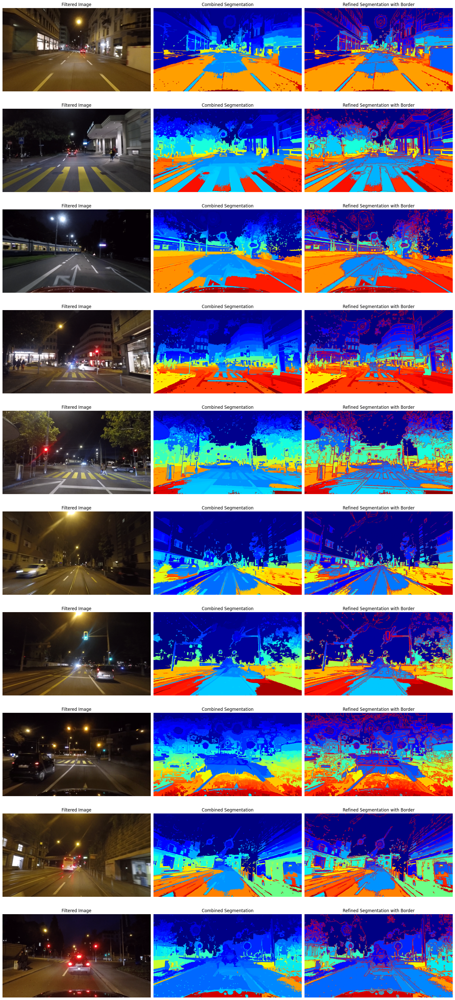

                        Image  VI Before  VI After  Improvement
01_frame_0906_leftImg8bit.png   5.031216  4.982178     0.049038
01_frame_0956_leftImg8bit.png   6.207049  6.144526     0.062522
01_frame_1536_leftImg8bit.png   5.907156  5.814218     0.092938
 0_frame_0075_leftImg8bit.png   6.813707  6.740471     0.073236
 0_frame_0205_leftImg8bit.png   6.918536  6.828748     0.089788
 0_frame_0932_leftImg8bit.png   4.339609  4.293208     0.046401
 0_frame_1434_leftImg8bit.png   4.940300  4.872821     0.067479
 0_frame_1687_leftImg8bit.png   8.029359  7.968956     0.060404
 0_frame_1816_leftImg8bit.png   5.119797  5.055255     0.064542
 0_frame_2728_leftImg8bit.png   5.305171  5.227702     0.077470


In [6]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.measure import regionprops
from skimage import morphology
from skimage.segmentation import mark_boundaries
import matplotlib.cm as cm
from skimage.filters import threshold_otsu
import pandas as pd
from skimage.metrics import variation_of_information as vi

def refine_segmentation(segmentation, min_area=64):
    """
    Refine segmentation by merging small regions with their dominant neighboring region.
    Parameters:
      segmentation: 2D numpy array of segmentation labels.
      min_area: Minimum area (in pixels) required for a region to be kept.
    Returns:
      refined: 2D numpy array of refined segmentation labels.
    """
    # Work on a copy to avoid modifying the original segmentation.
    refined = segmentation.copy()
    # Compute region properties (each region is identified by a unique label).
    regions = regionprops(refined)
    
    for region in regions:
        # Skip background (label 0) and regions meeting the minimum area.
        if region.label == 0 or region.area >= min_area:
            continue
        
        coords = region.coords  # Pixel indices in the small region.
        neighbor_labels = []
        # Check 8-connected neighbors for each pixel in the region.
        for (r, c) in coords:
            for dr in [-1, 0, 1]:
                for dc in [-1, 0, 1]:
                    if dr == 0 and dc == 0:
                        continue
                    nr, nc = r + dr, c + dc
                    if 0 <= nr < refined.shape[0] and 0 <= nc < refined.shape[1]:
                        neighbor_label = refined[nr, nc]
                        if neighbor_label != region.label:
                            neighbor_labels.append(neighbor_label)
        # Merge small region with the most common neighboring label.
        if neighbor_labels:
            new_label = max(set(neighbor_labels), key=neighbor_labels.count)
            refined[coords[:, 0], coords[:, 1]] = new_label

    # Further remove any remaining small regions.
    refined = morphology.remove_small_objects(refined, min_size=min_area)
    return refined

# ------------------------------------------------------------
# Use the output (combined_segmentations) as input for further processing.
# ------------------------------------------------------------

# Process each combined segmentation with additional region-based refinement.
processed_segmentations = []
for seg in combined_segmentations:
    # Ensure the segmentation is of integer type.
    if seg.dtype not in [np.int32, np.int64]:
        seg = seg.astype(np.int32)
    # Use a (possibly different) minimum area for this stage; here we use 96.
    refined_seg = refine_segmentation(seg, min_area=96)
    processed_segmentations.append(refined_seg)

# -----------------------------------------
# Visualization: Filtered Image, Combined Segmentation, and Refined Segmentation with Borders
# -----------------------------------------
num_images_to_show = min(len(best_filtered_images), len(processed_segmentations))
fig, axes = plt.subplots(num_images_to_show, 3, figsize=(18, 4 * num_images_to_show), constrained_layout=True)

for i in range(num_images_to_show):
    # Column 0: Original filtered image.
    axes[i, 0].imshow(cv2.cvtColor(best_filtered_images[i], cv2.COLOR_BGR2RGB))
    axes[i, 0].set_title("Filtered Image")
    axes[i, 0].axis("off")
    
    # Column 1: Combined segmentation (input to further processing).
    axes[i, 1].imshow(combined_segmentations[i], cmap="jet")
    axes[i, 1].set_title("Combined Segmentation")
    axes[i, 1].axis("off")
    
    # Column 2: Refined segmentation with border overlay.
    refined_seg = processed_segmentations[i]
    # Normalize segmentation for display using the jet colormap.
    if refined_seg.max() > 0:
        normalized_seg = refined_seg / refined_seg.max()
    else:
        normalized_seg = refined_seg
    cmap_jet = cm.get_cmap("jet")
    refined_rgb = (cmap_jet(normalized_seg)[:, :, :3] * 255).astype(np.uint8)
    # Overlay red boundaries on the refined segmentation.
    refined_with_border = mark_boundaries(refined_rgb, refined_seg, color=(1, 0, 0), mode='outer')
    
    axes[i, 2].imshow(refined_with_border)
    axes[i, 2].set_title("Refined Segmentation with Border")
    axes[i, 2].axis("off")

plt.show()

# -----------------------------------------
# Evaluation: Compare Variation of Information (VI) before and after region-based refinement.
# -----------------------------------------
evaluation_results = []
for i in range(len(best_filtered_images)):
    # Generate a baseline segmentation using Otsu thresholding.
    filtered_gray = cv2.cvtColor(best_filtered_images[i], cv2.COLOR_BGR2GRAY)
    baseline_thresh = threshold_otsu(filtered_gray)
    baseline_seg = (filtered_gray > baseline_thresh).astype(np.uint8)
    
    # VI for combined segmentation (before further refinement).
    vi_before = sum(vi(baseline_seg, combined_segmentations[i]))
    
    # VI for refined segmentation (after region-based processing).
    vi_after = sum(vi(baseline_seg, processed_segmentations[i]))
    
    improvement = vi_before - vi_after  # A positive value indicates improvement.
    evaluation_results.append({
        "Image": image_files[i],
        "VI Before": round(vi_before, 8),
        "VI After": round(vi_after, 8),
        "Improvement": round(improvement, 8)
    })

df_evaluation = pd.DataFrame(evaluation_results)
print(df_evaluation.to_string(index=False))


In [7]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage.measure import regionprops
from skimage import morphology
from skimage.segmentation import mark_boundaries
import matplotlib.cm as cm
from skimage.filters import threshold_otsu
import pandas as pd
from skimage.metrics import variation_of_information as vi, adapted_rand_error as are

# (Assuming combined_segmentations and processed_segmentations are produced from your previous code)

evaluation_results = []
for i in range(len(best_filtered_images)):
    # Generate a baseline segmentation using Otsu thresholding.
    filtered_gray = cv2.cvtColor(best_filtered_images[i], cv2.COLOR_BGR2GRAY)
    baseline_thresh = threshold_otsu(filtered_gray)
    baseline_seg = (filtered_gray > baseline_thresh).astype(np.uint8)  # binary ground truth

    # --------------------------------------
    # Variation of Information (VI)
    # --------------------------------------
    # VI for combined segmentation (before refinement).
    vi_before = sum(vi(baseline_seg, combined_segmentations[i]))
    # VI for refined segmentation (after region-based processing).
    vi_after = sum(vi(baseline_seg, processed_segmentations[i]))
    
    # --------------------------------------
    # Adapted Rand Error (ARE)
    # --------------------------------------
    are_before, _, _ = are(baseline_seg, combined_segmentations[i])
    are_after, _, _ = are(baseline_seg, processed_segmentations[i])
    
    # --------------------------------------
    # Dice Coefficient (for binary masks)
    # --------------------------------------
    # Convert segmentation results to binary masks.
    seg_before_binary = (combined_segmentations[i] > 0).astype(np.uint8)
    seg_after_binary = (processed_segmentations[i] > 0).astype(np.uint8)
    baseline_binary = baseline_seg  # already binary

    # Compute Dice coefficient: 2 * |intersection| / (|segmentation| + |baseline|)
    dice_before = 2 * np.sum(seg_before_binary * baseline_binary) / (np.sum(seg_before_binary) + np.sum(baseline_binary) + 1e-10)
    dice_after = 2 * np.sum(seg_after_binary * baseline_binary) / (np.sum(seg_after_binary) + np.sum(baseline_binary) + 1e-10)
    
    # Compute improvements (for VI and ARE, lower is better; for Dice, higher is better)
    improvement_VI = vi_before - vi_after
    improvement_ARE = are_before - are_after
    improvement_Dice = dice_after - dice_before
    
    evaluation_results.append({
        "Image": image_files[i],
        "VI Before": round(vi_before, 8),
        "VI After": round(vi_after, 8),
        "VI Improvement": round(improvement_VI, 8),
        "ARE Before": round(are_before, 8),
        "ARE After": round(are_after, 8),
        "ARE Improvement": round(improvement_ARE, 8),
        "Dice Before": round(dice_before, 8),
        "Dice After": round(dice_after, 8),
        "Dice Improvement": round(improvement_Dice, 8)
    })

df_evaluation = pd.DataFrame(evaluation_results)
print(df_evaluation.to_string(index=False))


                        Image  VI Before  VI After  VI Improvement  ARE Before  ARE After  ARE Improvement  Dice Before  Dice After  Dice Improvement
01_frame_0906_leftImg8bit.png   5.031216  4.982178        0.049038    0.807680   0.806662         0.001018     0.318424    0.318424          0.000000
01_frame_0956_leftImg8bit.png   6.207049  6.144526        0.062522    0.944854   0.944659         0.000195     0.528878    0.528711         -0.000167
01_frame_1536_leftImg8bit.png   5.907156  5.814218        0.092938    0.901654   0.901053         0.000601     0.345001    0.344923         -0.000077
 0_frame_0075_leftImg8bit.png   6.813707  6.740471        0.073236    0.986219   0.985762         0.000456     0.211323    0.211081         -0.000242
 0_frame_0205_leftImg8bit.png   6.918536  6.828748        0.089788    0.949854   0.949212         0.000642     0.493901    0.493225         -0.000675
 0_frame_0932_leftImg8bit.png   4.339609  4.293208        0.046401    0.883784   0.883082         0.